In [1]:
import os

import numpy as np
import pandas as pd

from PIL import Image



In [2]:
from skimage.metrics import structural_similarity, peak_signal_noise_ratio
from skimage.metrics import mean_squared_error

# define all metrics

def psnr(pred, gt):
    return peak_signal_noise_ratio(pred, gt)

def ssim(pred, gt):
    return structural_similarity(gt, pred, channel_axis=-1)



In [3]:
DATA_PATH = '/home/weders/scratch/scratch/03-PEOPLE/weders/datasets/scannet/scans'
RESULT_PATH = '../../pose_refinement/output'

os.listdir(RESULT_PATH)

['debug_1000_10',
 'debug_600_5_loftr_sequential',
 'debug_200_5_loftr_sequential',
 'debug_200_10_loftr',
 'point_to_plane_full',
 'debug',
 'point_to_plane_5_filter_retrieval',
 'debug_100_10',
 'scannet_pose_refinement_downsample_1_sequential_loftr',
 'scannet_pose_refinement',
 'debug_100_25',
 'point_to_plane_5',
 'debug_200_10',
 'scannet_pose_refinement_downsample_5_sequential+retrieval_loftr_no_icp',
 'debug_200_20_loftr_sequential',
 'point_to_plane_5_filter_retrieval_uncertain_threshold',
 'scannet_pose_refinement_downsample_5',
 'default',
 'scannet_pose_refinement_downsample_5_sequential_loftr_no_icp']

In [19]:
EXPERIMENT = 'scannet_pose_refinement_downsample_5_sequential+retrieval_loftr_no_icp'
SCENE = 'scene0575_00'

In [20]:
experiment_path = os.path.join(RESULT_PATH, EXPERIMENT, SCENE)


In [21]:
os.listdir(experiment_path)

['relative',
 'colmap',
 'nerf_raw',
 'absolute',
 'nerf_pgo',
 'scannet',
 'relative_pose_graph',
 'nerf_ba']

In [22]:
results = {'nerf': [], 'frame': [], 'ssim': [], 'psnr': []}


In [23]:
# evaluate nerf raw
nerf_exp = 'nerf_raw'

pred_path = os.path.join(experiment_path, nerf_exp, 'renderings')
gt_path = os.path.join(experiment_path, 'scannet/color_scaled')

pred_files = sorted([f for f in os.listdir(pred_path) if 'vis' not in f], key=lambda x: int(x.split('.')[0]))

for f in pred_files:
    f_pred = os.path.join(pred_path, f)
    f_gt = os.path.join(gt_path, f)
    
    img_pred = np.asarray(Image.open(f_pred))
    img_gt = np.asarray(Image.open(f_gt))

    results['nerf'].append('raw')
    results['frame'].append(f)
    results['ssim'].append(ssim(img_pred, img_gt))
    results['psnr'].append(psnr(img_pred, img_gt))

    



In [24]:
# evaluate nerf raw
nerf_exp = 'nerf_pgo'

pred_path = os.path.join(experiment_path, nerf_exp, 'renderings')
gt_path = os.path.join(experiment_path, 'scannet/color_scaled')

pred_files = sorted([f for f in os.listdir(pred_path) if 'vis' not in f], key=lambda x: int(x.split('.')[0]))

results_pgo = {'frame': [], 'ssim': [], 'psnr': []}

for f in pred_files:
    f_pred = os.path.join(pred_path, f)
    f_gt = os.path.join(gt_path, f)
    
    img_pred = np.asarray(Image.open(f_pred))
    img_gt = np.asarray(Image.open(f_gt))
    
    results['nerf'].append('pgo')
    results['frame'].append(f)
    results['ssim'].append(ssim(img_pred, img_gt))
    results['psnr'].append(psnr(img_pred, img_gt))


    



In [25]:
# evaluate nerf raw
nerf_exp = 'nerf_ba'

pred_path = os.path.join(experiment_path, nerf_exp, 'renderings')
gt_path = os.path.join(experiment_path, 'scannet/color_scaled')

pred_files = sorted([f for f in os.listdir(pred_path) if 'vis' not in f], key=lambda x: int(x.split('.')[0]))

results_ba = {'frame': [], 'ssim': [], 'psnr': []}

for f in pred_files:
    f_pred = os.path.join(pred_path, f)
    f_gt = os.path.join(gt_path, f)
    
    img_pred = np.asarray(Image.open(f_pred))
    img_gt = np.asarray(Image.open(f_gt))
    
        
    results['nerf'].append('ba')
    results['frame'].append(f)
    results['ssim'].append(ssim(img_pred, img_gt))
    results['psnr'].append(psnr(img_pred, img_gt))

    


In [26]:
results_pd = pd.DataFrame(results)

In [27]:
results_pd.groupby('nerf').mean()

/tmp/ipykernel_17217/2683964134.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  results_pd.groupby('nerf').mean()


,ssim,psnr
nerf,,
ba,0.729236,24.253450
pgo,0.734369,24.897988
raw,0.735238,24.482229


In [13]:
results_pd

,nerf,frame,ssim,psnr
0,raw,0.jpg,0.642903,21.464268
1,raw,50.jpg,0.664947,21.693968
2,raw,100.jpg,0.647191,20.056648
3,raw,150.jpg,0.628395,20.411901
4,raw,200.jpg,0.671232,21.159330
...,...,...,...,...
145,ba,2250.jpg,0.736175,24.025437
146,ba,2300.jpg,0.731921,23.527980
147,ba,2350.jpg,0.753054,26.167051
148,ba,2400.jpg,0.755340,25.507281


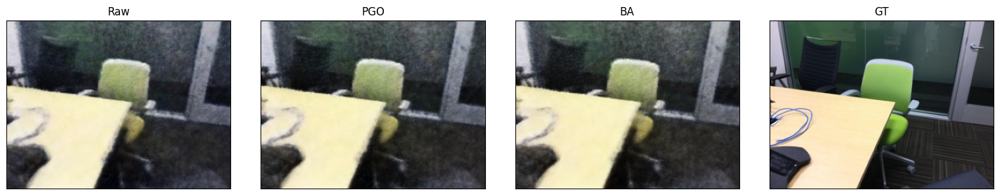

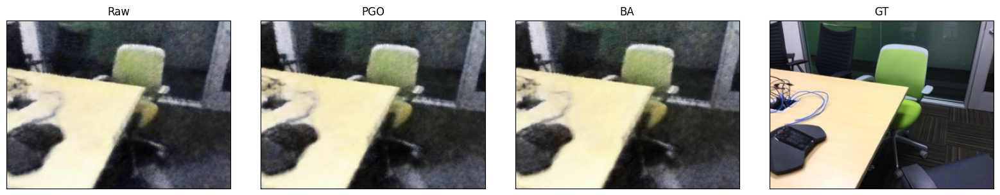

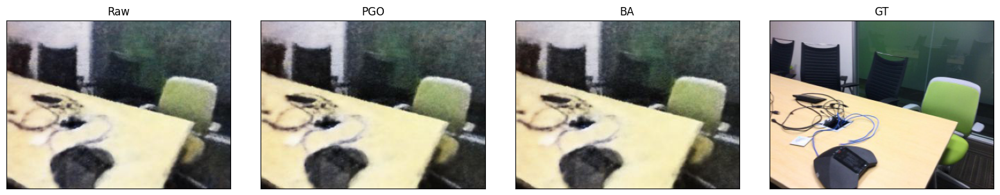

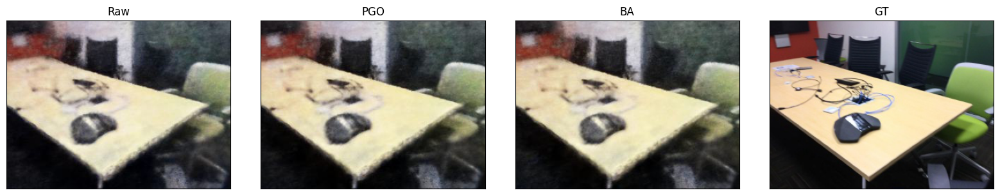

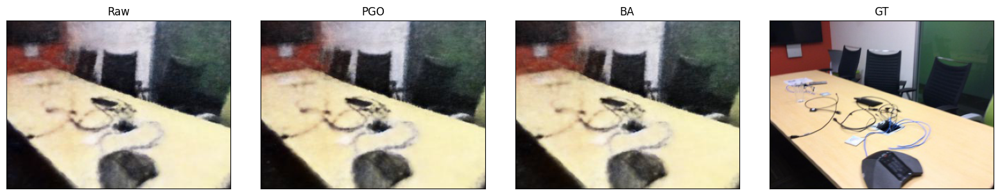

...

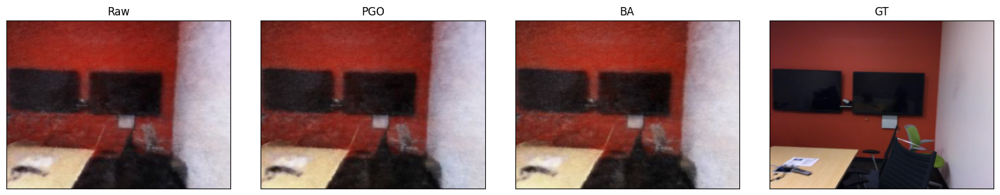

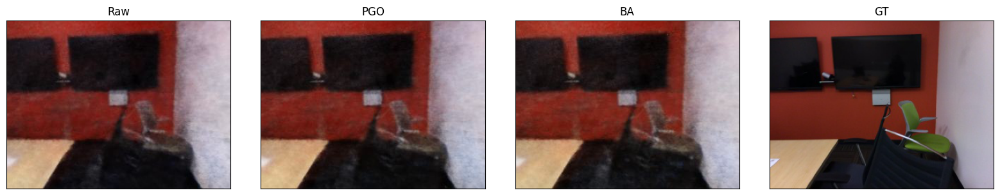

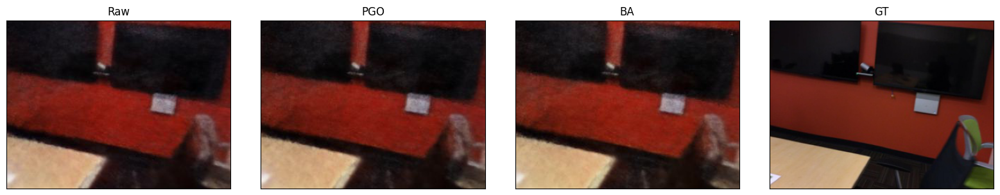

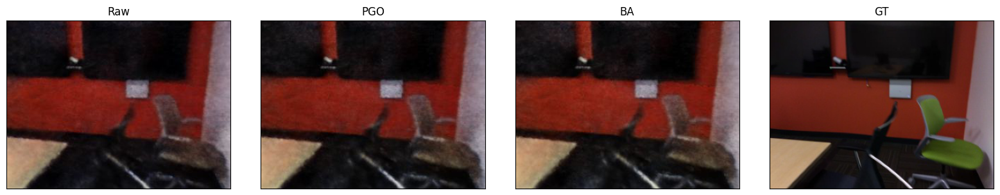

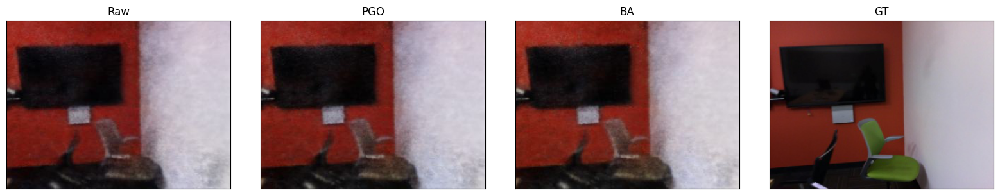

In [28]:
# visualize all images
import matplotlib.pyplot as plt


gt_path = os.path.join(experiment_path, 'scannet/color_scaled')
pred_raw_path = os.path.join(experiment_path, 'nerf_raw', 'renderings')
pred_pgo_path = os.path.join(experiment_path, 'nerf_pgo', 'renderings')
pred_ba_path = os.path.join(experiment_path, 'nerf_ba', 'renderings')

for f in pred_files:
    
    f_pred_raw = os.path.join(pred_raw_path, f)
    f_pred_pgo = os.path.join(pred_pgo_path, f)
    f_pred_ba = os.path.join(pred_ba_path, f)
    f_gt = os.path.join(gt_path, f)
    
    img_raw = np.asarray(Image.open(f_pred_raw))
    img_pgo = np.asarray(Image.open(f_pred_pgo))
    img_ba = np.asarray(Image.open(f_pred_ba))
    img_gt = np.asarray(Image.open(f_gt))
    
    fig, ax = plt.subplots(1, 4, figsize=(4 * 4, 3))
    ax[0].imshow(img_raw)
    ax[1].imshow(img_pgo)
    ax[2].imshow(img_ba)
    ax[3].imshow(img_gt)
    ax[0].set_title('Raw')
    ax[1].set_title('PGO')
    ax[2].set_title('BA')
    ax[3].set_title('GT')
    
    for ax_ in ax:
        ax_.set_xticks([])
        ax_.set_yticks([])
    plt.tight_layout()
    plt.show()
    

